# YOLOv8

## Instalação e Configuração

In [ ]:
!pip install ultralytics #Download YoloV8

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 663.2/663.2 kB 3.6 MB/s eta 0:00:00


In [ ]:
import ultralytics

In [ ]:
ultralytics.checks() #Check system informations

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.3/107.7 GB disk)


In [ ]:
import torch
torch.cuda.is_available() #Show if Cuda is on

False

In [ ]:
# conda install pytorch torchvision torchaudio pytorch-cuda=11.7 -c pytorch -c nvidia

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


### Clonar repositório (alternativa)

In [ ]:
#!git clone https://github.com/ultralytics/ultralytics
#!pip install -r /content/ultralytics/requirements.txt
#!pip install -qe ultralytics

### Importação das demais bibliotecas

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os
from PIL import Image
from google.colab.patches import cv2_imshow

## Download do modelo

- Os modelos do YOLOv8 podem ser baixados aqui:
https://github.com/ultralytics/assets/releases

In [ ]:
#!wget https://github.com/ultralytics/assets/releases/download/v0.0.0/yolov8n.pt

## Realizando a detecção

A forma mais rápida de executar a deteçcão é através da CLI, conforme pode ver abaixo a sintaxe.

Os parâmetros:
* **task** - tarefa, podendo ser detecção, segmentação ou classificação
* **model** - o modelo que queremos usar. São disponibilizados 5 modelos: YOLOv8n (nano), YOLOv8s (small), YOLOv8m (medium), YOLOv8l (large), YOLOv8x (extra large). Nano é o mais rápido e o menor (menos pesado para rodar), enquanto que o Extra Large (YOLOv8x) é o mais preciso porém mais pesado para rodar, portanto será mais lento.
  Para o valor desse parâmetro, basta informar o nome e ao lado .pt pois é a extensão do modelo treinado em pytorch.

* **mode** - basicamente é o que queremos com o comando. queremos fazer a detecção/inferência/predição, portanto deixe =predict. Valores aceitos: [train, val, predict, export]

* **conf** - o limiar (threshold) que usaremos para filtrar detecções "fracas". Se a confiança estiver abaixo desse valor, não será considerada. Por padrão podemos configurar com um limiar bem baixo (ex: 0.25) e depois aumentar, caso verifique que detectou incorretamente algum objeto.  
* **source** - a imagem ou vídeo que queremos fazer a detecção.

In [ ]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='/content/cachorros.jpg' save=True
#!yolo task=[detect, train, etc.)] mode=[train, val, predict, export] model=[modelUsed] conf=[threshold] source=['/directoryOrURLto/img.jpg'] save=[True to salve | False to not save]

100% 6.23M/6.23M [00:00<00:00, 80.2MB/s]
Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

image 1/1 /content/cachorros.jpg: 448x640 3 dogs, 307.5ms
Speed: 20.9ms preprocess, 307.5ms inference, 31.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [ ]:
def mostrar(img):
  fig = plt.gcf()
  fig.set_size_inches(16,10)
  plt.axis('off')
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

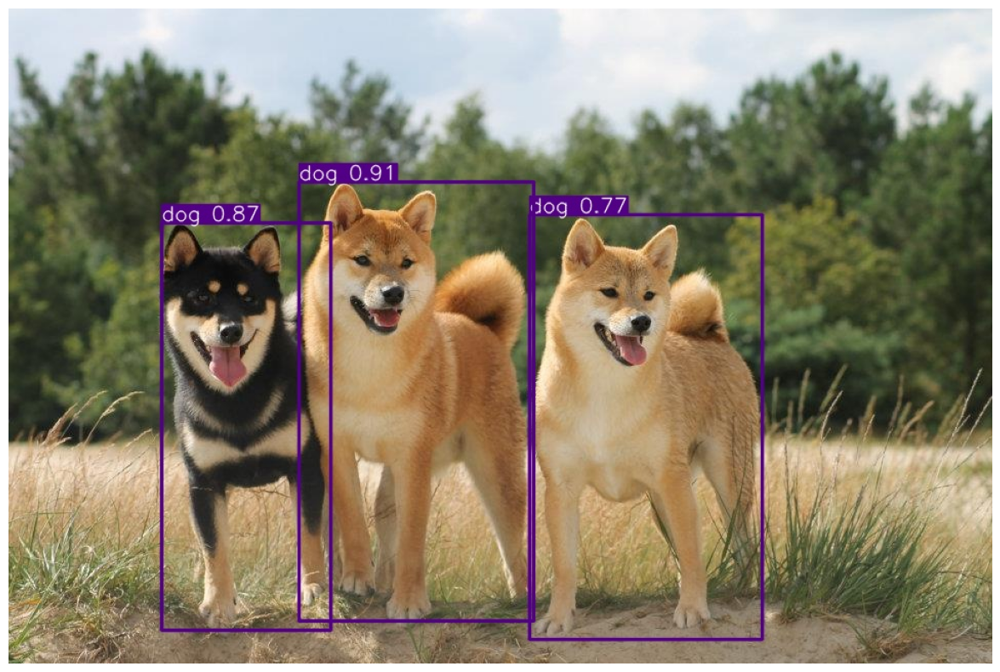

In [ ]:
resultado = cv2.imread('/content/runs/detect/predict/cachorros.jpg')
mostrar(resultado)

In [ ]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='https://ultralytics.com/images/zidane.jpg' save=True

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

100% 356k/356k [00:00<00:00, 591kB/s]
image 1/1 /content/20211129_00588mo.jpg: 448x640 1 person, 1 tie, 1 bottle, 1 chair, 1 laptop, 242.3ms
Speed: 7.0ms preprocess, 242.3ms inference, 2.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict3
💡 Learn more at https://docs.ultralytics.com/modes/predict


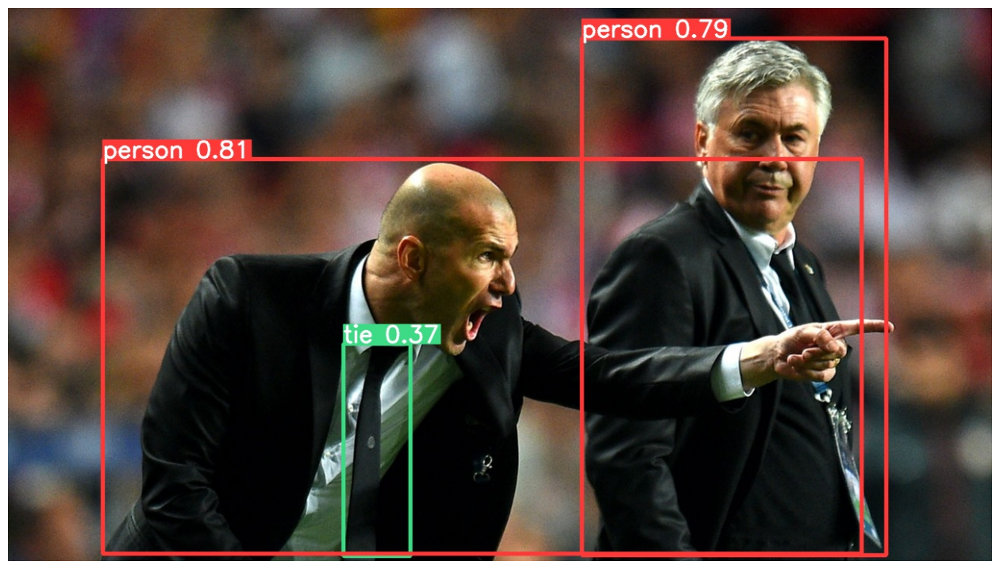

In [ ]:
resultado = cv2.imread('/content/runs/detect/predict2/zidane.jpg')
mostrar(resultado)

### Alterando o limiar (threshold)

In [ ]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.4 source='/content/italia.jpg' save=true

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

image 1/1 /content/italia.jpg: 512x640 11 persons, 1 bicycle, 1 handbag, 3 clocks, 478.7ms
Speed: 20.3ms preprocess, 478.7ms inference, 2.1ms postprocess per image at shape (1, 3, 512, 640)
Results saved to runs/detect/predict3
💡 Learn more at https://docs.ultralytics.com/modes/predict


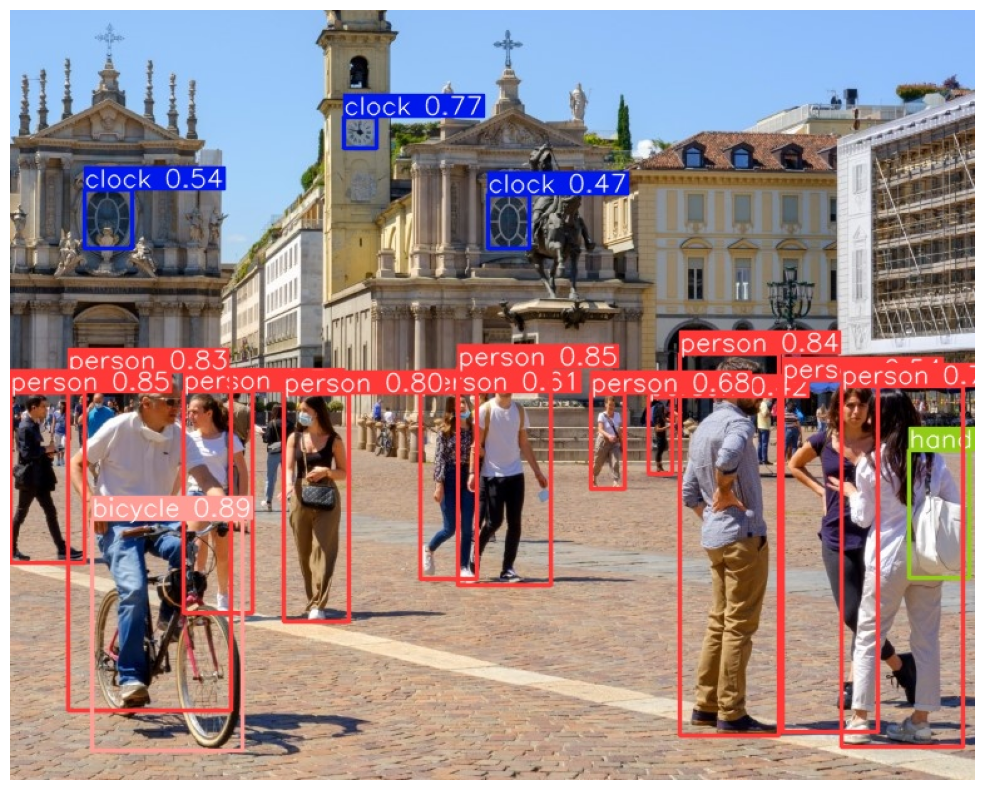

In [ ]:
resultado = cv2.imread('/content/runs/detect/predict3/italia.jpg')
mostrar(resultado)

In [ ]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.6 source='/content/italia.jpg' save=true

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

image 1/1 /content/italia.jpg: 512x640 9 persons, 1 bicycle, 1 clock, 424.7ms
Speed: 11.1ms preprocess, 424.7ms inference, 3.6ms postprocess per image at shape (1, 3, 512, 640)
Results saved to runs/detect/predict5
💡 Learn more at https://docs.ultralytics.com/modes/predict


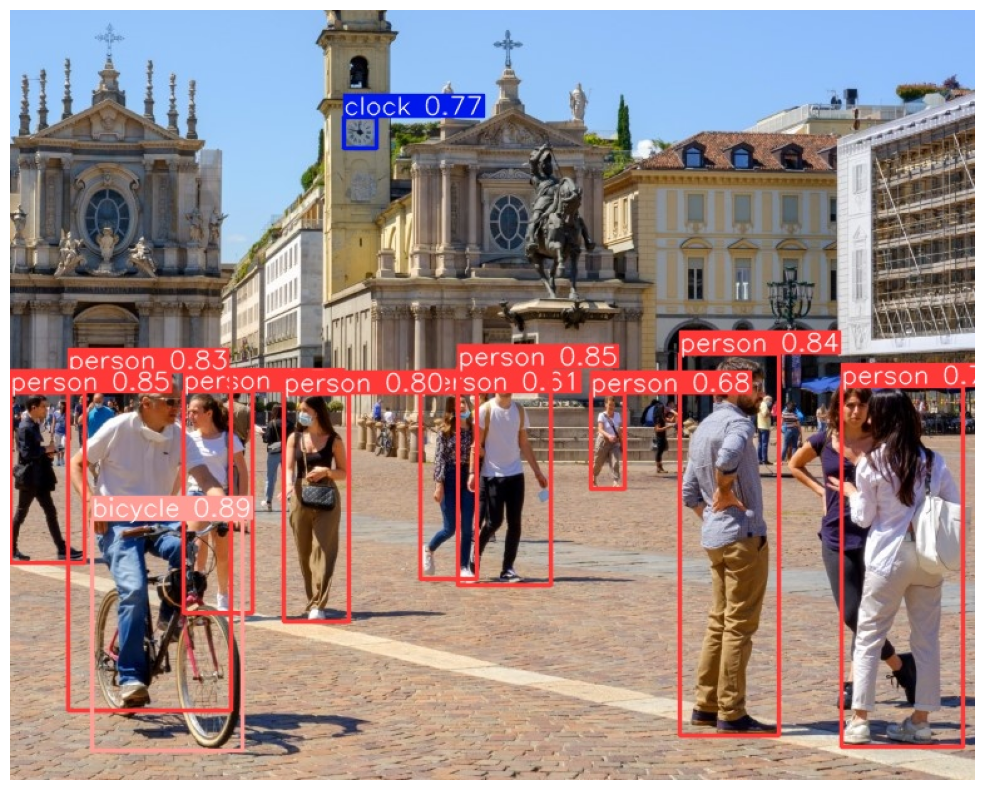

In [ ]:
resultado = cv2.imread('/content/runs/detect/predict4/italia.jpg')
mostrar(resultado)

## Detecção em múltiplas imagens de uma vez

In [ ]:
!yolo task=detect mode=predict model=yolov8n.pt conf=0.5 source='/content/imagens' save=true
#source='/content/imagens' => Predict the objects in all the pictures inside the folder

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs

image 1/9 /content/imagens/cachorros.jpg: 448x640 3 dogs, 263.1ms
image 2/9 /content/imagens/cachorros02.jpg: 448x640 2 dogs, 184.4ms
image 3/9 /content/imagens/dog.jpg: 480x640 1 bicycle, 1 car, 1 truck, 1 dog, 221.4ms
image 4/9 /content/imagens/gato02.jpg: 480x640 1 cat, 172.1ms
image 5/9 /content/imagens/gato03.jpg: 608x640 1 cat, 1 bed, 255.8ms
image 6/9 /content/imagens/gato04.jpg: 480x640 2 cats, 187.7ms
image 7/9 /content/imagens/img-canecas.jpg: 480x640 6 cups, 1 dining table, 199.7ms
image 8/9 /content/imagens/italia.jpg: 512x640 10 persons, 1 bicycle, 2 clocks, 195.7ms
image 9/9 /content/imagens/person.jpg: 448x640 1 person, 1 dog, 1 horse, 169.1ms
Speed: 4.4ms preprocess, 205.5ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict5
💡 Learn more at https://docs.u

In [ ]:
dir_resultados = '/content/runs/detect/predict5/'

In [ ]:
caminhos = [os.path.join(dir_resultados, f) for f in os.listdir(dir_resultados)]
print(caminhos)

['/content/runs/detect/predict5/cachorros.jpg', '/content/runs/detect/predict5/person.jpg', '/content/runs/detect/predict5/dog.jpg', '/content/runs/detect/predict5/gato04.jpg', '/content/runs/detect/predict5/gato03.jpg', '/content/runs/detect/predict5/gato02.jpg', '/content/runs/detect/predict5/img-canecas.jpg', '/content/runs/detect/predict5/cachorros02.jpg', '/content/runs/detect/predict5/italia.jpg']


In [ ]:
for caminho_imagem in caminhos:
  #print(caminho_imagem)
  imagem = cv2.imread(caminho_imagem)
  mostrar(imagem)

Output hidden; open in https://colab.research.google.com to view.

## Realizando a detecção - método através do Python

In [ ]:
from ultralytics import YOLO

In [ ]:
model = YOLO('yolov8n.pt')#Choiche the kind of model we will use

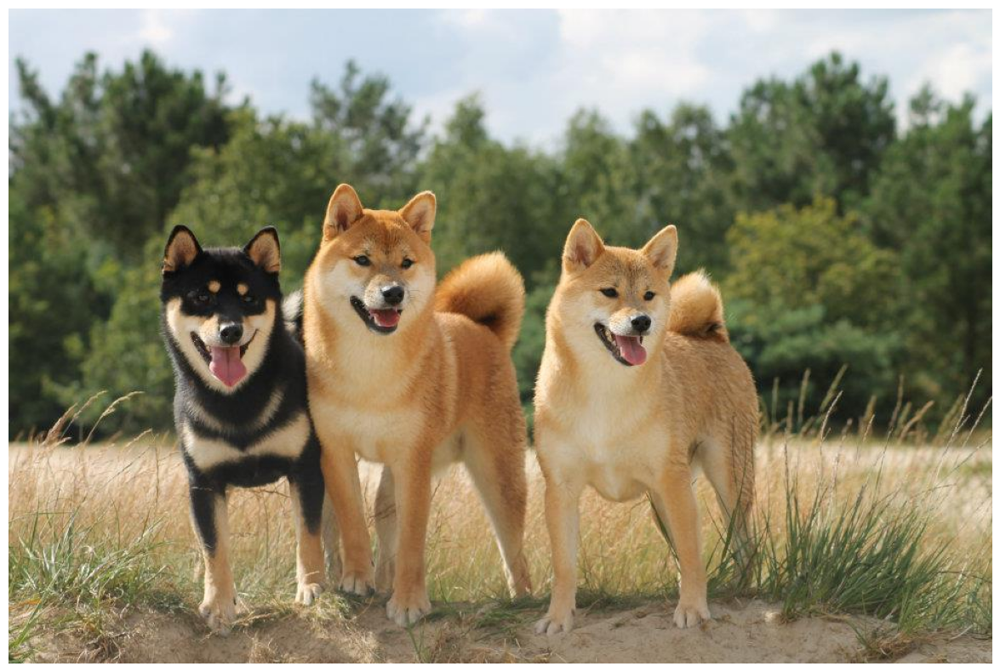

In [ ]:
caminho_img = '/content/imagens/cachorros.jpg'
img = cv2.imread(caminho_img)
mostrar(img)

Para a deteção usaremos o método model.predict().

Ele aceita basicamente os mesmos parâmetros do método via CLI, que vimos nos exemplos mais acima.

* source -- A função aceita a imagem nos seguintes formatos:
  * imagem em ndarray (usando o cv2.imread) ou PIL
  * diretório
  * caminho
  * URL
  * video
  * webcam (valor 0, que corresponde ao indice do dispositivo de câmera)

* save -- se desejar salvar a imagem no diretório predict deixei save=True. aqui nós vamos fazer de outra maneira, então não precisa setar esse parâmetro

* conf -- limiar de confiança

* show -- Informe o parâmetro show=True para mostrar os valores das predições

* save_txt -- se deseja salvar em um txt os resultados

mais parâmetros https://docs.ultralytics.com/cfg/

In [ ]:
resultados = model.predict(source=img)#Try predict


0: 448x640 3 dogs, 241.9ms
Speed: 6.9ms preprocess, 241.9ms inference, 2.4ms postprocess per image at shape (1, 3, 448, 640)


In [ ]:
resultados

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted p

In [ ]:
for r in resultados:
  print(r.boxes.data)#Show the bouding boxes data

tensor([[283.1483, 169.5603, 512.2313, 598.1078,   0.9150,  16.0000],
        [149.1904, 209.6510, 314.2391, 607.8404,   0.8709,  16.0000],
        [508.2393, 201.4497, 735.6066, 616.0237,   0.7686,  16.0000]])


In [ ]:
for r in resultados:
  print(r.boxes.conf)#Show the confidence

tensor([0.9150, 0.8709, 0.7686])


### Desenhando a caixa delimitadora sobre a imagem



In [ ]:
import funcoes_desenho

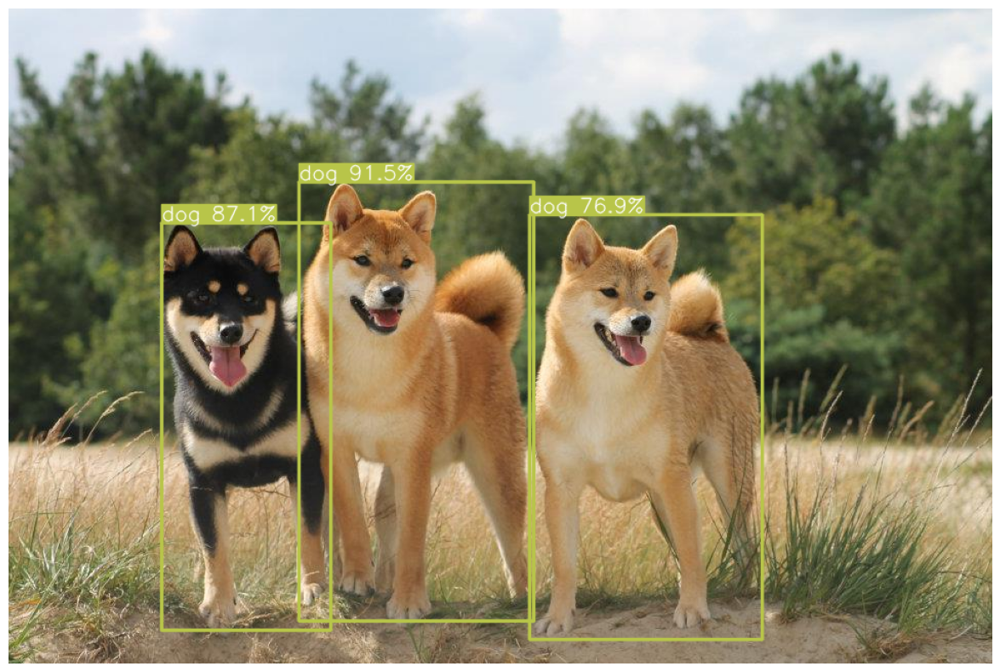

In [ ]:
resultado = funcoes_desenho.desenha_caixas(img, resultados[0].boxes.data)
mostrar(resultado)

## Teste com outros modelos


100%|██████████| 49.7M/49.7M [00:00<00:00, 144MB/s]



0: 512x640 10 persons, 1 bicycle, 1 handbag, 1 clock, 1398.3ms
Speed: 4.0ms preprocess, 1398.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)


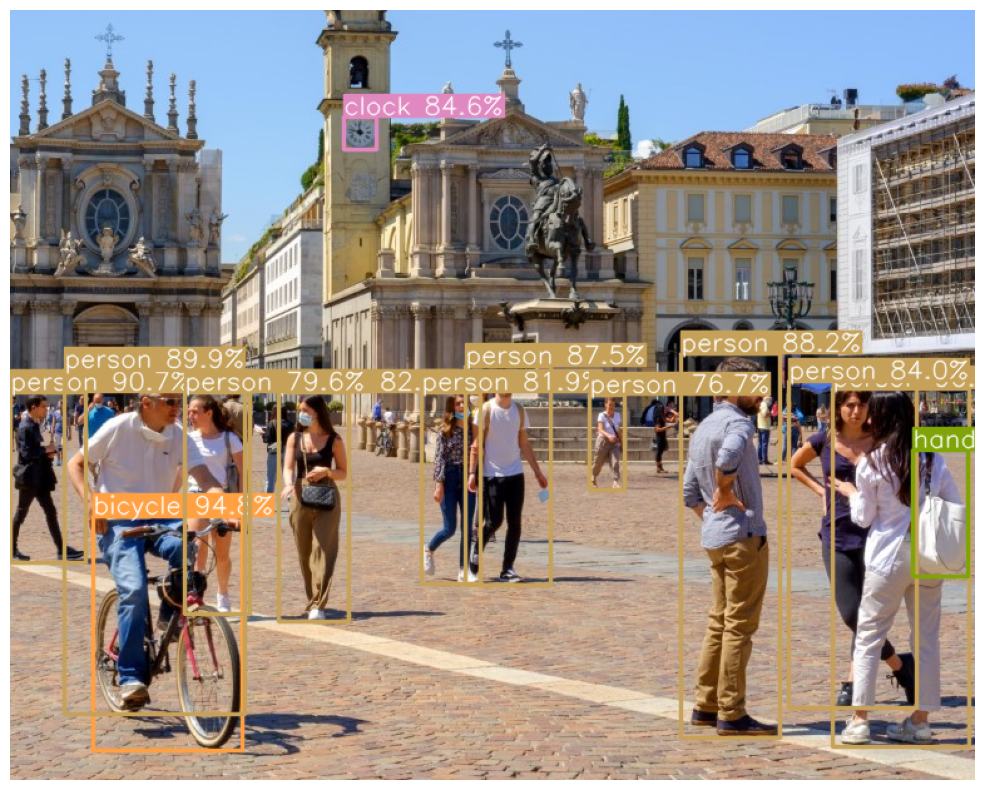

In [ ]:
model = YOLO('yolov8m.pt')#Load the model
caminho_img = '/content/imagens/italia.jpg'#Specify the directory
img = cv2.imread(caminho_img)#Read the image
resultados = model.predict(source = img, conf=0.6)#Try predict
resultado_img = funcoes_desenho.desenha_caixas(img, resultados[0].boxes.data)#Storage the image with the bouding boxes
mostrar(resultado_img)

> Usando o YOLOv8x (extra large)


0: 608x640 1 cat, 1 bed, 1 laptop, 4481.0ms
Speed: 5.2ms preprocess, 4481.0ms inference, 8.0ms postprocess per image at shape (1, 3, 608, 640)


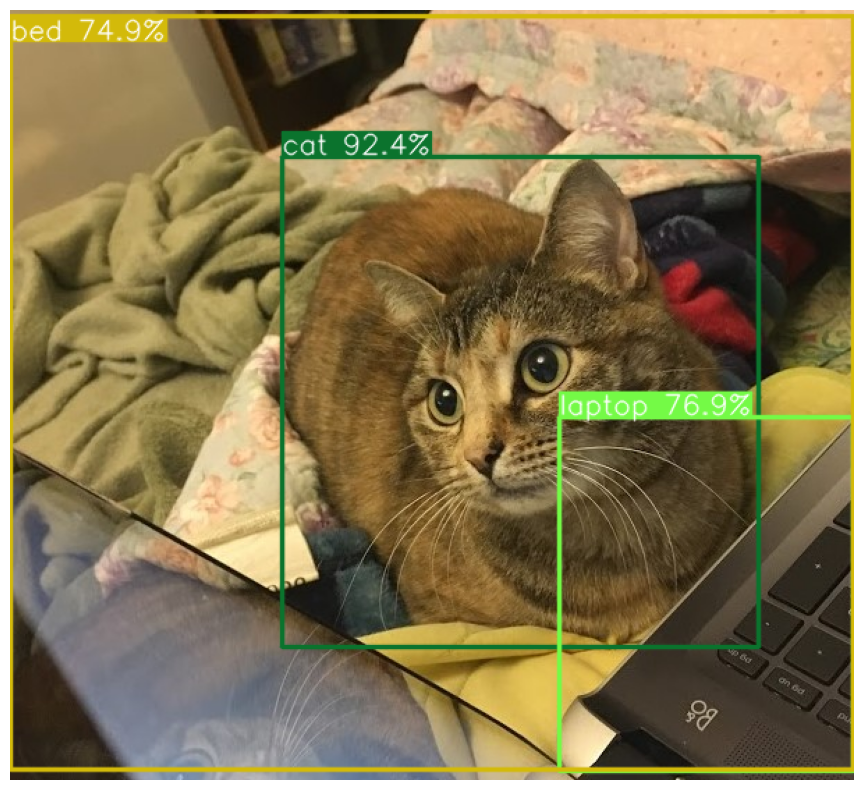

In [ ]:
model = YOLO('yolov8x.pt')#Load the model
caminho_img = '/content/imagens/gato03.jpg'#Specify the directory
img = cv2.imread(caminho_img)#Read the image
resultados = model.predict(source = img, conf=0.6)#Try predict
resultado_img = funcoes_desenho.desenha_caixas(img, resultados[0].boxes.data)#Storage the image with the bouding boxes
mostrar(resultado_img)

## Validação do modelo

In [ ]:
import torch
torch.hub.download_url_to_file('https://ultralytics.com/assets/coco2017val.zip', 'tmp.zip')#Download some images for validation

100%|██████████| 780M/780M [00:08<00:00, 96.8MB/s]


In [ ]:
!unzip -q tmp.zip -d ../datasets && rm tmp.zip #Extract them

unzip:  cannot find or open tmp.zip, tmp.zip.zip or tmp.zip.ZIP.


In [ ]:
!yolo task=detect mode=val model=yolov8m.pt data=coco128.yaml
#Try validate the Neural Network

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8m summary (fused): 218 layers, 25886080 parameters, 0 gradients, 78.9 GFLOPs
val: Scanning /content/datasets/coco128/labels/train2017.cache... 126 images, 2 backgrounds, 0 corrupt: 100% 128/128 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 8/8 [03:46<00:00, 28.33s/it]
                   all        128        929      0.712       0.73      0.784      0.613
                person        128        254       0.83       0.74      0.856      0.654
               bicycle        128          6          1      0.625      0.789      0.579
                   car        128         46      0.757      0.339      0.552      0.306
            motorcycle        128          5      0.761          1      0.962      0.805
              airplane        128          6      0.826          1      0.995      0.928
                   bus        128       

## Detecção em vídeos

In [53]:
!yolo task=detect mode=predict model=yolov8m.pt conf=0.5 source='/content/video_pessoas01.mp4' save=true
#Try detect the objects in the video

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 5, in <module>
    from ultralytics.cfg import entrypoint
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/__init__.py", line 5, in <module>
    from ultralytics.models import RTDETR, SAM, YOLO
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/models/__init__.py", line 3, in <module>
    from .rtdetr import RTDETR
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/models/rtdetr/__init__.py", line 3, in <module>
    from .model import RTDETR
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/models/rtdetr/model.py", line 10, in <module>
    from ultralytics.engine.model import Model
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/model.py", line 8, in <module>
    from ultralytics.cfg import TASK2DATA, get_cfg, get_save_dir
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 10, in <module>
    from ultralytics.utils import (ASSET

In [57]:
#Aplica a compressão de vídeo no vídeo de resultado
import os
video_salvo = '/content/runs/detect/predict6/video_pessoas01.avi'#Diretório dop vídeo a ser processado
video_final = '/content/video_pessoas01_resultado.mp4'#Novo diretório do vídeo após ter sido aplicado a compressão
os.system(f"ffmpeg -i {video_salvo} -vcodec libx264 {video_final}")#Aplica a compressão

0

In [58]:
def exibir_video(video_caminho):
  from IPython.display import HTML
  from base64 import b64encode
  mp4 = open(video_caminho, 'rb').read()#Read the file
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()#Create the URL to visualize

  #Create the HTML content to show the video
  return HTML("""
  <video width=500 controls>
    <source src="%s" type="video/mp4"
  </video>
  """ % data_url)

In [59]:
exibir_video(video_final)

Output hidden; open in https://colab.research.google.com to view.

## Segmentação de imagens

### Via CLI

In [60]:
#Segment the image
!yolo task=segment mode=predict model=yolov8m-seg.pt conf=0.5 source='/content/imagens/cachorros.jpg' save=true

100% 52.4M/52.4M [00:00<00:00, 179MB/s]
Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8m-seg summary (fused): 245 layers, 27268704 parameters, 0 gradients, 110.2 GFLOPs

image 1/1 /content/imagens/cachorros.jpg: 448x640 3 dogs, 2296.1ms
Speed: 11.3ms preprocess, 2296.1ms inference, 24.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/segment/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


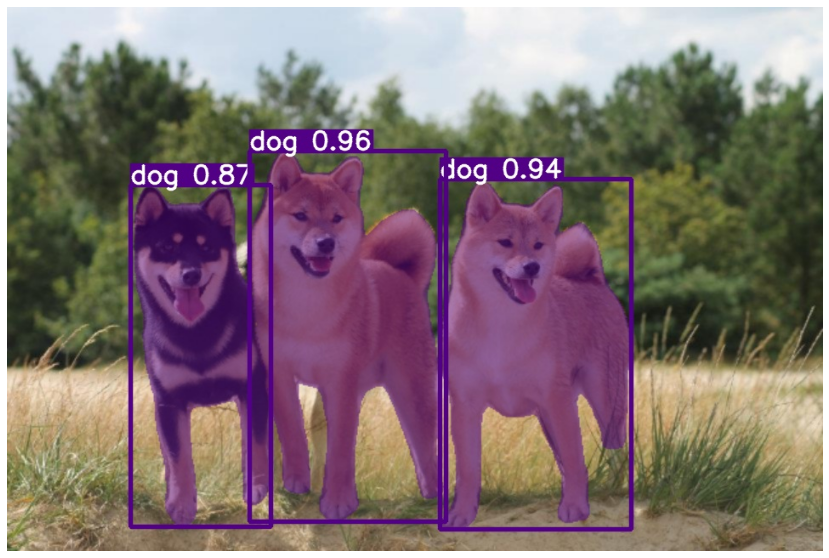

In [ ]:
resultado = cv2.imread('/content/runs/segment/predict/cachorros.jpg')
mostrar(resultado)

### Via Python


0: 480x640 1 cat, 1 umbrella, 1674.8ms
Speed: 13.8ms preprocess, 1674.8ms inference, 7.6ms postprocess per image at shape (1, 3, 480, 640)


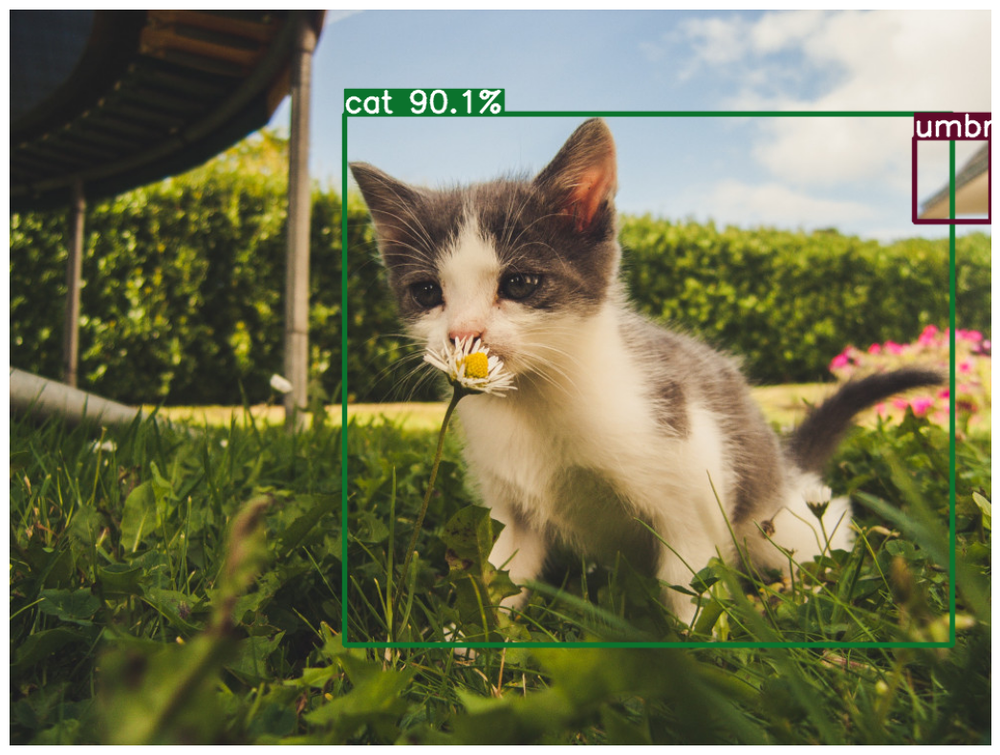

In [63]:
model_seg = YOLO('yolov8m-seg.pt')#Informs the model
caminho_img = '/content/imagens/gato02.jpg'#Informs the directory
img = cv2.imread(caminho_img)#Read the image
resultados = model_seg.predict(source=img, conf=0.6)#Try segment the image
resultado_img = funcoes_desenho.desenha_caixas(img, resultados[0].boxes.data)#Draw the bouding boxes
mostrar(resultado_img)

100%|██████████| 137M/137M [00:00<00:00, 166MB/s]



0: 448x640 1 person, 1 dog, 1 horse, 4050.7ms
Speed: 2.7ms preprocess, 4050.7ms inference, 14.2ms postprocess per image at shape (1, 3, 448, 640)


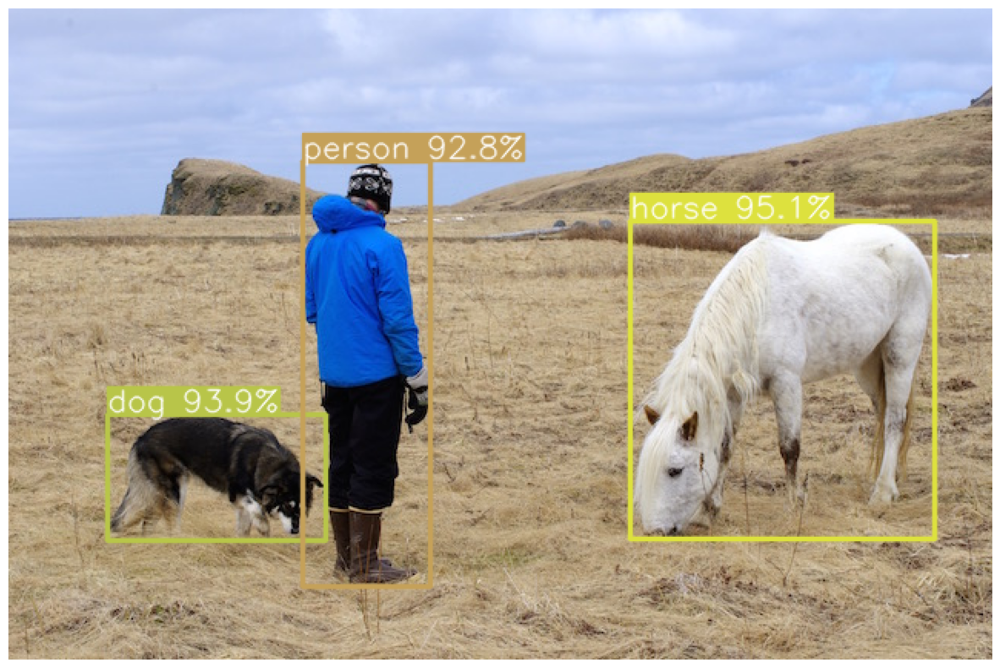

In [64]:
model_seg = YOLO('yolov8x-seg.pt')
caminho_img = '/content/imagens/person.jpg'
img = cv2.imread(caminho_img)
resultados = model_seg.predict(source=img, conf=0.6)
resultado_img = funcoes_desenho.desenha_caixas(img, resultados[0].boxes.data)
mostrar(resultado_img)

### Segmentação em vídeos

In [65]:
!wget https://github.com/gabevr/yolo/raw/master/videos/video_rua01.mp4

--2023-12-23 19:04:13--  https://github.com/gabevr/yolo/raw/master/videos/video_rua01.mp4
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/gabevr/yolo/master/videos/video_rua01.mp4 [following]
--2023-12-23 19:04:13--  https://raw.githubusercontent.com/gabevr/yolo/master/videos/video_rua01.mp4
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5645465 (5.4M) [application/octet-stream]
Saving to: ‘video_rua01.mp4’

video_rua01.mp4     100%[===================>]   5.38M  --.-KB/s    in 0.08s   

2023-12-23 19:04:14 (66.2 MB/s) - ‘video_rua01.mp4’ saved [5645465/5645465]



In [ ]:
!yolo task=segment mode=predict model=yolov8m-seg.pt conf=0.5 source='/content/video_rua01.mp4' save=true

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8m-seg summary (fused): 245 layers, 27268704 parameters, 0 gradients, 110.2 GFLOPs

video 1/1 (1/349) /content/video_rua01.mp4: 384x640 2 persons, 1 car, 1480.6ms
video 1/1 (2/349) /content/video_rua01.mp4: 384x640 2 persons, 2 cars, 1958.9ms
video 1/1 (3/349) /content/video_rua01.mp4: 384x640 3 persons, 1 car, 1741.9ms
video 1/1 (4/349) /content/video_rua01.mp4: 384x640 4 persons, 1 car, 1256.6ms
video 1/1 (5/349) /content/video_rua01.mp4: 384x640 5 persons, 1 car, 1226.1ms
video 1/1 (6/349) /content/video_rua01.mp4: 384x640 5 persons, 1 car, 1248.8ms
video 1/1 (7/349) /content/video_rua01.mp4: 384x640 6 persons, 1 car, 1233.0ms
video 1/1 (8/349) /content/video_rua01.mp4: 384x640 7 persons, 1 car, 1190.8ms
video 1/1 (9/349) /content/video_rua01.mp4: 384x640 8 persons, 1 car, 1206.2ms
video 1/1 (10/349) /content/video_rua01.mp4: 384x640 8 persons, 1 car, 1197.4ms
video 1/1 (11/349) /content/video_

In [ ]:
#Aplica a compressão de vídeo no vídeo de resultado
video_salvo = "/content/runs/segment/predict2/video_rua01.mp4"
video_final = "/content/segmentacao_rua01.mp4"

os.system(f"ffmpeg -i {video_salvo} -vcodec libx264 {video_final}")

0

In [ ]:
exibir_video(video_final)